<a href="https://colab.research.google.com/github/jojoroy/mlcw2/blob/main/coursework_2_01857917.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 510.5/510.5 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 15.0 MB/s eta 0:00:00


In [ ]:
import torch.nn.functional as F
from torchvision import transforms
from torch.utils.data import DataLoader
import numpy as np
import torch
from torch.optim import Adam
from torch import nn
from datasets import load_dataset
from torchvision.transforms import Compose, ToTensor, Lambda, ToPILImage, CenterCrop, Resize
import matplotlib.pyplot as plt
import math
from tqdm import tqdm

### Part 1. On attention [2 points]

Answer each question in max. 3 lines. Points will be subtracted for long answers so be short and precise. Add your explanations in the below box - NO added handwritten images, write in latex!

1. [0.5 point] You are given an input $X=[x_1,...,x_L]$ (e.g. a sentence of tokenised words). Your goal is to predict the next token $x_i$ conditional on $x_{1},...,x_{i}$. In other words, the $i$-th position can only be influenced by a position $j$ if and only if $j \leq i$, namely a position cannot be influenced by the subsequent positions.
    a. What would be the problem when passing $X$ through attention? Explain using the computations that attention performs, e.g. you can write out the matrix multiplication.
    b. How could you ensure that the prediction for position $i$ depends solely on positions $j\leq i$? Hint: what in the attention computation should be masked & in what way?
2. [0.5 point] Let's consider multi-head attention. How does multi-head attention change the computations inside the softmax (the $QK^T$ term) and the product with $V$ and why could this be beneficial to learning?
3. [0.5 point] Remember that standard attention is given by
\begin{align}
Q = XW^Q, \; K=XW^K, \; V=XW^V, \;\; \text{with } A(X) = softmax\left(\frac{QK^T}{\sqrt{D}}\right)V
\end{align}
for a sequence $X\in\mathbb{R}^{L\times D}$ with $L$ the sequence length.
What is the memory and computational cost of attention in terms of the sequence length and where does this come from?
4. [0.5 point] A big focus these days is on making attention more computationally efficient. The $i$-th row (as a vector) of attention can be rewritten as,
\begin{align}
A(X)_i = \frac{\sum_{j=1}^L sim(Q_i,K_j)V_j}{\sum_{j=1}^L sim(Q_i,K_j)},
\end{align}
with $sim(q,k)=exp(q^Tk/\sqrt{D})$.
Linear attention would be given by,
\begin{align}
A(X)_i = \frac{\sum_{j=1}^L \phi(Q_i)^T\phi(K_j)V_j}{\sum_{j=1}^L\phi(Q_i)^T\phi(K_j)}.
\end{align}
Explain the relation between regular attentin and linear attention (i.e. what kind of similarity function does linear attention assume and how is the approximation made?) & how the above expression can be rewritten and use this to explain why linear attention computation can be done more efficiently compared to standard attention.

Fill in your answers below.



1.
Specifically, for a given position , the attention scores $A(X)_i$ are computed as follows:
$$A(X)_i = softmax\left(\frac{Q_iK^T}{\sqrt{D}}\right)V$$
where $Q_i$ is the query vector at position $i$, $K$ is the matrix of key vectors for all positions.

Without masking, the dot product between $Q_i$ and all key vectors $K$ means attention score is calculated using all the values in $X$.

$$
A(X) = softmax\left(\frac{QK^T+M}{\sqrt{D}}\right)V
$$

where $M$ is a matrix with 0 on the diagonal and below the diagonal, above the diagonal the entries will be a large negative number like 1e-9. The softmax will map these large negative values to 0, so the entries above the diagonal in $QK^T+M$ will be irrelevant in further calculation.


2. For multihead attention we project $X$ and create $Q$, $K$ and $V$ scores for each head and use the normal formula to get an attention score $A_h$ for each head. Finally, we concatenate these heads and obtain the final attention score by postmultiplying the concatenated attention scores with a projection matrix. By doing it this way, attention can be given to different parts of the sequence in parallel and allows the model to learn more complex relationships.

3. Memory cost primarily comes from storing $Q$, $K$, and $V$ where if we assume a linear transformation which makes this cost $O(L\times D)$. Computational cost from creating $Q$, $K$ and $V$ is $O(LD^2)$ due to the matrix multiplications, computing $QK^T$ is $O(L^2D)$ and multiplying the result from the softmax with $V$ gives $O(L^2D)$ so the total computational cost is $O(LD^2+DL^2)$.

4. Linear attention assumes the similarity function $sim(q,k)=\phi(q)^T\phi(k)$. All we need for the similarity function is that it is nonnegative so for linear attention you can use kernel functions. You can rewrite linear attention as
\begin{align}
A(X)_i &= \frac{\phi(Q_i)^T \sum_{j=1}^L \phi(K_j)V_j^T}{\phi(Q_i)^T \sum_{j=1}^L\phi(K_j)}.
\end{align}
  Computational cost is scaled down by a factor of $L$ because we can compute $\sum_{j=1}^L \phi(K_j)V_j^T$ and $\sum_{j=1}^L\phi(K_j)$ once and reuse them for every query.



### Part 2. On diffusion models [12 points]

We will be implementing a diffusion model. We will follow mostly the setup as done here: https://arxiv.org/pdf/2006.11239.pdf so please refer to this work for more details if needed.

Your goal will be to implement the code for the diffusion model, find the right configuration to train the model, achieve good accuracy and efficiency and finally interpret how the model learns. You will be marked on clean code, concise answers and good results.

We will be working with the FashionMNIST dataset. You can load the data using the below code.

In [ ]:
IMG_SIZE = 28
BATCH_SIZE = 128

# load dataset from the hub
dataset = load_dataset("fashion_mnist")
channels = 1

# define image transformations (e.g. using torchvision)
transform = Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Lambda(lambda t: (t * 2) - 1)
])

# define function
def transforms(examples):
    examples["pixel_values"] = [transform(image.convert("L")) for image in examples["image"]]
    del examples["image"]
    return examples

transformed_dataset = dataset.with_transform(transforms).remove_columns("label")

dataloader = DataLoader(transformed_dataset['train'], batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split:   0%|          | 0/60000 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/10000 [00:00<?, ? examples/s]

The following helper functions will be useful. In particular, whenever we input a vector (list) of values, this will help to select the right time t output. We will use this in the sampling loops.

In [ ]:
def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

##### 1. The noising process [2 points]

[1.5 pts] Our first step will be to implement the forward process that adds noise to an image.

We will be adding noise according to a linear schedule, i.e. the noises $\beta_t$, $t=1,...,T$ will come from an equally spaced vector. Implement the `linear_beta_schedule` function. Remember $\alpha_t = 1-\beta_t$ and $\bar \alpha_t = \prod_{s=1}^t \alpha_s$.

Remember that we have the closed-form solutions for the image at time $t$. Use those in the implementation of `forward_diffusion_sample` instead of a for loop over each noising step. This means you will need to implement `sqrt_one_minus_alphas_cumprod` which represents $\sqrt{1-\bar\alpha_t}$ and `sqrt_alphas_cumprod` which represents $\sqrt{\bar\alpha_t}$.

Test the function on an image from the dataset using the given code below.

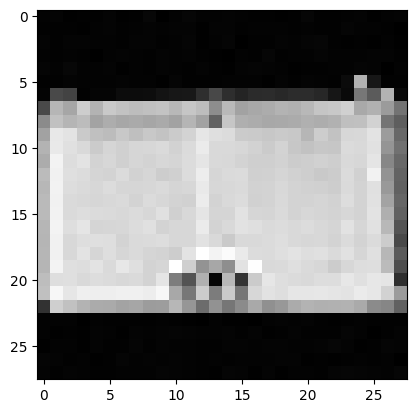

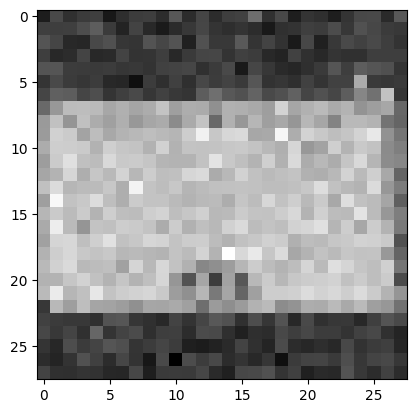

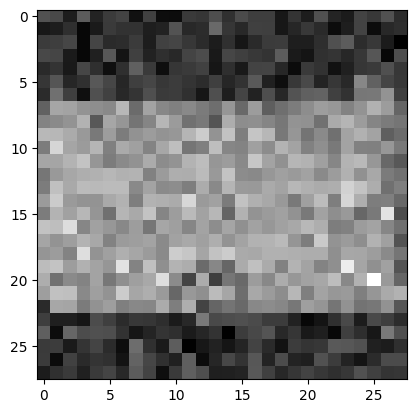

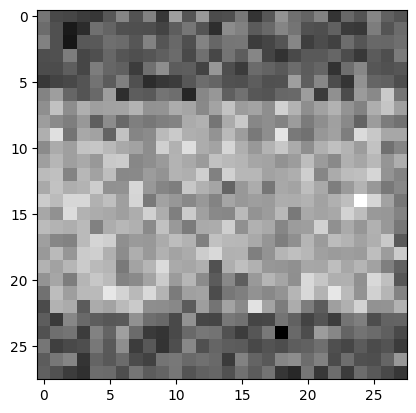

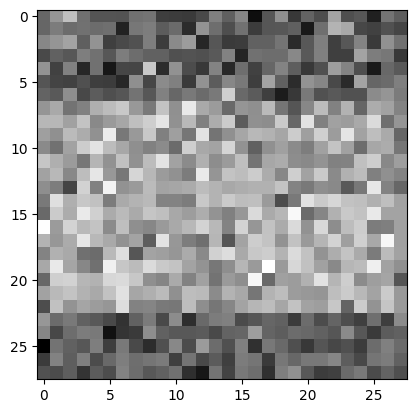

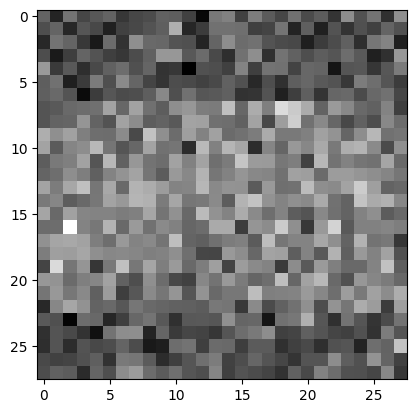

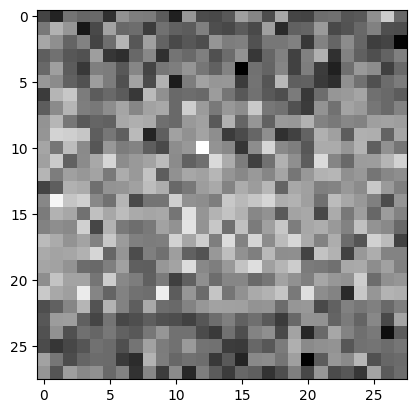

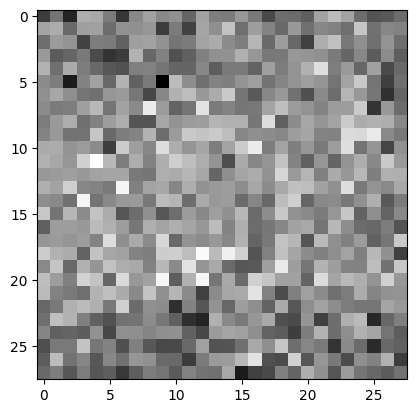

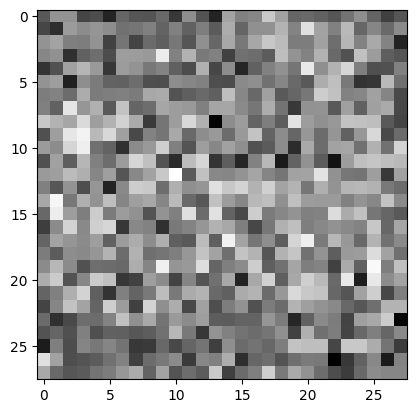

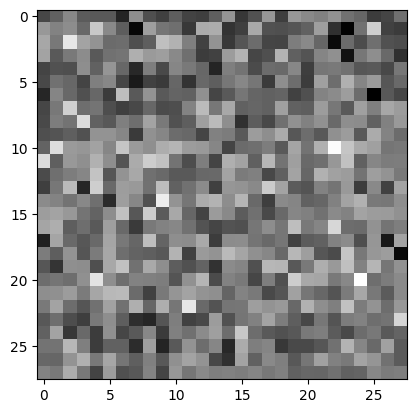

In [ ]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    '''
    output a vector of size timesteps that is equally spaced between start and end; this will be the noise that is added in each time step.
    '''

    return torch.linspace(start,end,steps=timesteps)

def forward_diffusion_sample(x_0, t,sqrt_alphas_cumprod , sqrt_one_minus_alphas_cumprod, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    Hint: use the get_index_from_list function to select the right values at time t.
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)
# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
# ADD HERE THE COMPUTATIONS NEEDED for sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod
alphas_cumprod = torch.cumprod(torch.ones_like(betas)-betas,dim=0)
sqrt_alphas_cumprod=torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod=torch.sqrt(torch.ones_like(betas)-alphas_cumprod)

# Simulate forward diffusion
batch = next(iter(dataloader))["pixel_values"]
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    img, noise = forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)

    plt.imshow(img.reshape(28, 28), cmap="gray")
    plt.show()

[0.5 pt] Play around with the noise (compare two different beta schedules), present results for the two settings and discuss (in max. 3 lines) how the hyperparameters change the forward sampling.

Answer: With the larger $T=500$, we notice at each timestep the image produced by forward diffusion is noisier than the samaller $T=100$. The times are nearer together in the beta schedule for $T=500$ yet it appears more noise is added quicker in this setting than the $T=100$ setting.

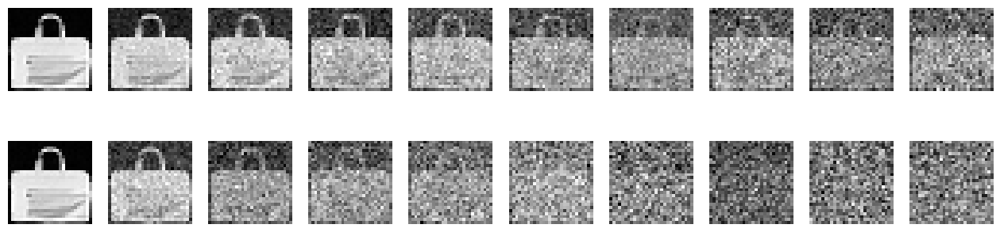

In [ ]:
Ts=[100,500]
fig, axes = plt.subplots(2, 10, figsize=(16, 4))
batch = next(iter(dataloader))["pixel_values"]
for j in range(2):
  T=Ts[j]
  betas = linear_beta_schedule(timesteps=T)

  # Pre-calculate different terms for closed form
  # ADD HERE THE COMPUTATIONS NEEDED for sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod
  alphas_cumprod = torch.cumprod(torch.ones_like(betas)-betas,dim=0)
  sqrt_alphas_cumprod=torch.sqrt(alphas_cumprod)
  sqrt_one_minus_alphas_cumprod=torch.sqrt(torch.ones_like(betas)-alphas_cumprod)

  # Simulate forward diffusion

  num_images = 10
  stepsize = int(T/num_images)

  for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    img, noise = forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)

    #plt.figure(figsize=(12, 6))
    #plt.suptitle(title, fontsize=16)
    #for i in range(T):
    #plt.subplot(2, T, int(idx/stepsize +1))
    axes[j][int(idx/stepsize )].imshow(img.reshape(28, 28), cmap='gray')  # Assuming grayscale images
    axes[j][int(idx/stepsize )].axis('off')
      #plt.title(f'Timestep {i+1}')
plt.show()


In [ ]:
# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
# ADD HERE THE COMPUTATIONS NEEDED for sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

##### 2. The model for the noise [4 points]

We use a simple form of a UNet to predict the noise in the image. The input into the neural network will be a noisy image and the ouput from the model will be the noise in the image. It is important to also pass in the timestep into the neural network (so the model knows at which time we want to denoise the image) and we do this by passing it through a sinusoidal position embedding.

[0.5pt] Write code for the Sinusoidal Position Embedding. This should output a matrix $PE$ of size `[timesteps, dimension]` with elements:

\begin{align}
&PE_{pos,2i} = \sin\left(\frac{pos}{10000^{2i/dim}}\right),\\
&PE_{pos,2i+1} = \cos\left(\frac{pos}{10000^{2i/dim}}\right),
\end{align}
where `pos` refers to the time position and `i` refers to the dimension position and `dim` the total dimension we are working with.

Use however the following identity to implement:
\begin{align}
\frac{pos}{10000^{2i/dim}} = \exp\left(\log(pos) - \frac{2i}{dim}\log(10000)\right).
\end{align}

In [ ]:
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        '''
        Fill in the code
        '''
        device = time.device
        pe = torch.zeros((time.size()[0],self.dim),device=device)
        pos = time.unsqueeze(1)
        angle = torch.exp(torch.arange(0,self.dim,2,device=device)* -(math.log(10000.0) / self.dim))
        pe[: , 0::2] = torch.sin(pos * angle)
        pe[:, 1::2] = torch.cos(pos * angle)


        return pe



[0.5pt] Visualise the positional embeddings with arbitary time and dimension and discuss what position embeddings do (why do we add them, why this particular embedding structure) in max. 3 lines.



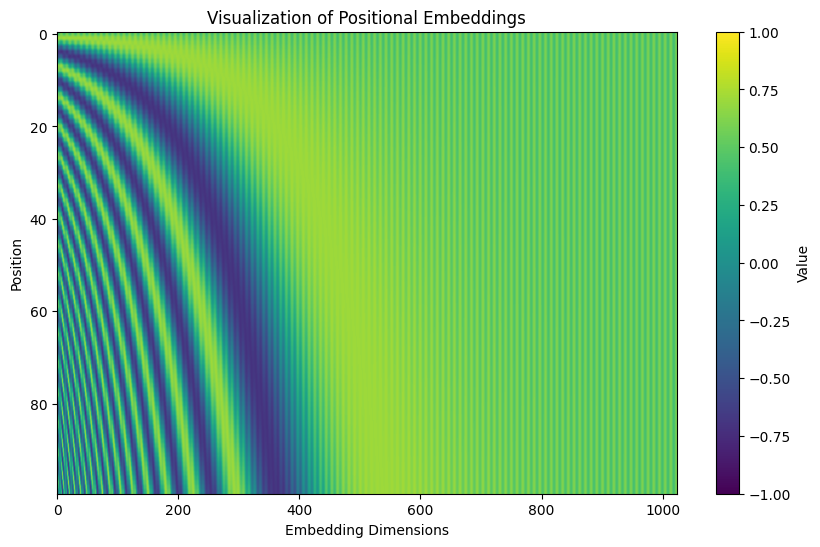

In [ ]:
# Write here the code to visualise the positional embedding
max_len = 100
position = torch.arange(0, max_len, dtype=torch.float)
dim = 1024
embedding_module = SinusoidalPositionEmbeddings(dim)
positional_embeddings = embedding_module.forward(position).squeeze().numpy()

plt.figure(figsize=(10, 6))
plt.imshow(positional_embeddings, cmap='viridis', aspect='auto')
plt.xlabel('Embedding Dimensions')
plt.ylabel('Position')
plt.colorbar(label='Value')
plt.title('Visualization of Positional Embeddings')
plt.show()

Add here your discussion on the positional embeddings.

Answer: Positional encoding describes the location or position of an entity in a sequence so that each position is assigned a unique representation. In this case, the part of the image and which timestep we want to sample the noise from needs a unique representation. This embedding structure allows information about the time we wish to sample the noise and the unique parts of the image to be taken into account.

Below is the code for a Block, that will make up the final UNet.

[0.5pt] Fill in the missing parts.

Remember that in the UNet architecture, we have a downsampling phase and an upsampling phase. Depending on which phase we are in, we need to make use of the up or down-sample operations.

[0.5pt] Add here an explanation as to what the block does including the up and downsample operations in maximum 3 lines:

Explanation of a Block:
The up keyword determines if it is upsampling or downsampling. If it is upsampling, the image channels are doubled and then reduced by a factor of 4 at the start of the forward and at the end nn.ConTranspose2d is used to adjust the spatial dimensions. If it is downsampling, the image channels are reduced in the first convolution and a nn.Conv2d is used to adjust the spatial dimensions. In the middle of this block forward, a time embedding is added to introduce information about the time.

In [ ]:
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        '''
        in_ch refers to the number of channels in the input to the operation and out_ch how many should be in the output
        '''
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t):
        '''
        Define the forward pass making use of the components above.
        Time t should get mapped through the time_mlp layer + a relu
        The input x should get mapped through a convolutional layer with relu / batchnorm
        The time embedding should get added the output from the input convolution
        A second convolution should be applied and finally passed through the self.transform.
        '''
        # First Conv
        temp = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        temp = temp + time_emb

        # Second Conv
        temp = self.bnorm2(self.relu(self.conv2(temp)))
        # Down or Upsample
        return self.transform(temp)


[1.5pt] Use the above code to fill in the code for the UNet below.

In [ ]:
class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 1
        down_channels = (56, 112, 224) # These are the channels that we want to obtain in the downsampling stage; DEFINE YOURSELF!
        up_channels = (224,112,56) # These are the channels that we want to obtain in the upsampling stage; DEFINE YOURSELF!
        out_dim = 1 # DEFINE THIS CORRECTLY
        time_emb_dim = 28 # DEFINE THIS CORRECTLY

        # Time embedding consists of a Sinusoidal embedding, a linear map that maintains the dimensions and a rectified linear unit activation.
        # TO WRITE CODE
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection consisting of a map from image_channels to down_channels[0] with a filter size of e.g. 3 and padding of 1.
        # TO WRITE CODE
        self.projection = nn.Conv2d(image_channels,down_channels[0], 3, padding=1)

        # Downsample: use the Blocks given above to define down_channels number of downsampling operations. These operations should cha
        # TO WRITE CODE HERE; HINT: use something like Block(down_channels[i], down_channels[i+1], time_emb_dim) the right number of times.
        self.downsamples = nn.ModuleList([
            Block(down_channels[i], down_channels[i+1], time_emb_dim, up = False) for i in range(len(down_channels) - 1)
        ])

        # Upsample
        # TO WRITE CODE HERE; same logic as the downsample
        self.upsamples = nn.ModuleList([
            Block(up_channels[i], up_channels[i+1], time_emb_dim, up = True) for i in range(len(up_channels) - 1)
        ])

        # Final output: given by a final convolution that maps up_channels[-1] to out_dim with a kernel of size 1.
        # TO WRITE CODE
        self.final_conv = nn.Conv2d(up_channels[-1], out_dim, kernel_size=1)


    def forward(self, x, timestep):
        # Embedd time
        # TO DO
        # Initial conv
        # TO DO
        # Unet: iterate through the downsampling operations and the upsampling operations. Do not forget to include the residual connections
        # between the outputs from the downsample stage and the upsample stage.
        # Embedd time
        t = self.time_mlp(timestep)
        #print(t.size())
        # Initial conv
        x = self.projection(x)
        #print(x.size())
        # Unet
        residual_inputs = []
        for down in self.downsamples:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.upsamples:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.final_conv(x)




[0.5pt] Finally, define a loss function. Note that this loss function should take x_0 and t to sample the forward diffusion model, get a noisy image, use this noisy image in the model to get the noise added and finally compare true added noise and model outputs added noise.

In [ ]:
def get_loss(model, x_0, t):
    '''
    Define the right loss given the model, the true x_0 and the time t
    '''
    x_noisy, noise = forward_diffusion_sample(x_0, t,sqrt_alphas_cumprod , sqrt_one_minus_alphas_cumprod, device=t.device)
    noise_pred = model(x_noisy, t)
    return F.mse_loss(noise, noise_pred)



##### Part 3: The sampling [1 point]

Write a piece of code that can be used to predict the noise and return the denoised image. This function should work on a single image and make sure that the function can be used in the `sample` function properly. Note that we will need the `posterior_variance` denoted by $\sigma$ in the paper and the `sqrt_recip_alphas` given by $1/\alpha_t$. Make sure to set the right choice of $\sigma$ (see the paper).

In [ ]:
# compute posterior_variance
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod) # FILL IN WITH THE RIGHT SETUP;
sqrt_recip_alphas = torch.sqrt(1.0 / alphas) # FILL IN WITH THE RIGHT SETUP;

@torch.no_grad()
def sample_timestep(x, t, i, posterior_variance, sqrt_one_minus_alphas_cumprod, sqrt_alphas_cumprod, model):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    Note that it also needs additional arguments about the posterior_variance, sqrt_minus_alphas_cumprod and sqrt_recip_alphas.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:

        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise




@torch.no_grad()
def sample(model, shape):
    device = next(model.parameters()).device

    b = shape[0]
    # start from pure noise (for each example in the batch)
    img = torch.randn(shape, device=device)
    imgs = []
    for i in tqdm(reversed(range(0, T)), desc='sampling loop time step', total=T):
        t = torch.full((b,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t, i, posterior_variance, sqrt_one_minus_alphas_cumprod, sqrt_recip_alphas, model)
        imgs.append(img.cpu().numpy())
    return imgs

##### Part 4. Write the training loop and present & interpret your results [6 points]

Code a training loop that instantiates the model, defines an optimiser, defines a number of epochs, iterates over the epochs and the datapoints inside the epoch and for each iteration samples a timestep, uses this timestep to loss function and update parameters based on this.

Note: this is the part requiring most computational resources. You may need to train the model for quite a few epochs to get good results. Be sure to start on time to ensure enough access to GPUs on Google Colab.

0.5 point will be given for correct implementation.

1.5 points will be given according to how many **sensible** samples (with max points given for 10 good samples; scaled accordingly for less samples) you manage to obtain (i.e. the performance of your model in generating good datapoints).

2 points will be given according to how efficient you can make the train process to still produce at least 10 good samples. You are free to change anything in the architecture! Your output will be compared to my base setup which uses `50` epochs and has a model with `Num params:  929409`. 1 point will be assigned scaled according to how much less epochs you can use and 1 points scaled with how much less params you manage to use. Be sure to print your number of parameters, training epochs and the 10 sensible images.

2 points will be given for the interpretation of your results that allows us to better understand *how* the model learns. For this you are asked to visualise the generated samples during the training process. Can you identify any properties of *how* the model learns? Are there particular aspects the model starts paying attention to / is able to generate before others?

In [ ]:
# Code for the training loop goes here
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 40 # Try more!

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()
      img=batch.get('pixel_values')

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model,img, t)
      loss.backward()
      optimizer.step()

      if step % 100 == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")


Num params:  2826293
Epoch 0 | step 000 Loss: 1.0238438844680786 
Epoch 0 | step 100 Loss: 0.1255544126033783 
Epoch 0 | step 200 Loss: 0.11967461556196213 
Epoch 0 | step 300 Loss: 0.12585511803627014 
Epoch 0 | step 400 Loss: 0.10158885270357132 
Epoch 1 | step 000 Loss: 0.09851808100938797 
Epoch 1 | step 100 Loss: 0.08858665078878403 
Epoch 1 | step 200 Loss: 0.08770526945590973 
Epoch 1 | step 300 Loss: 0.09386835247278214 
Epoch 1 | step 400 Loss: 0.0921667069196701 
Epoch 2 | step 000 Loss: 0.07240735739469528 
Epoch 2 | step 100 Loss: 0.07458613812923431 
Epoch 2 | step 200 Loss: 0.08328579366207123 
Epoch 2 | step 300 Loss: 0.07607398927211761 
Epoch 2 | step 400 Loss: 0.09191790968179703 
Epoch 3 | step 000 Loss: 0.08855584263801575 
Epoch 3 | step 100 Loss: 0.07311122119426727 
Epoch 3 | step 200 Loss: 0.09406221657991409 
Epoch 3 | step 300 Loss: 0.08771465718746185 
Epoch 3 | step 400 Loss: 0.08088056743144989 
Epoch 4 | step 000 Loss: 0.07210364937782288 
Epoch 4 | step 1

Finally, after training is done, use the `sample` to sample new images.

In [ ]:
# Code for the plotting of samples goes here
shape=(1, 1, IMG_SIZE, IMG_SIZE)
imagessample=[]
for j in range(100):

  imagessam = sample(model,shape)
  imagessample.append(imagessam[-1])

sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 243.06it/s]


Include your best generated samples below.

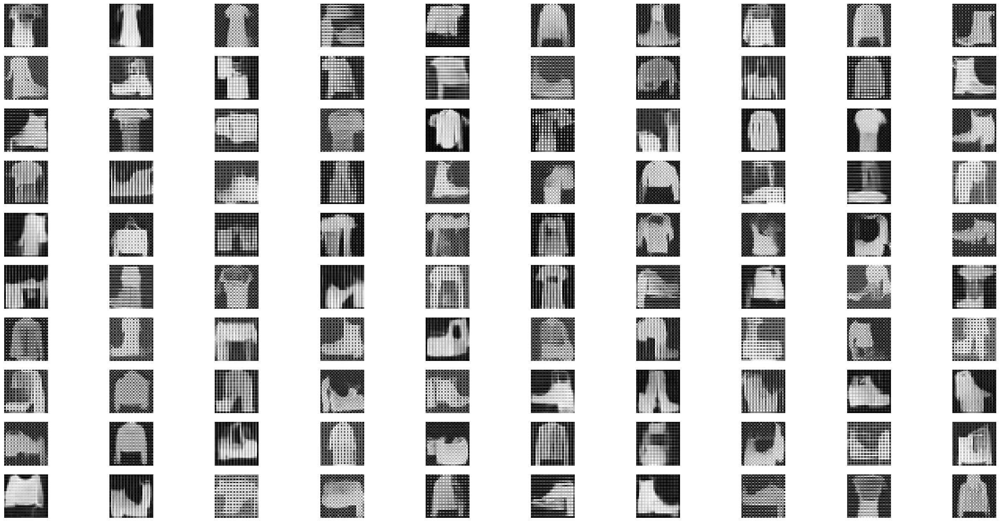

In [ ]:
fig, axes = plt.subplots(10, 10, figsize=(32, 16))
for j in range(10):
  for idx in range(10):

    axes[j][idx].imshow(imagessample[j*10+idx].reshape(28, 28), cmap='gray')  # Assuming grayscale images
    axes[j][idx].axis('off')

plt.show()

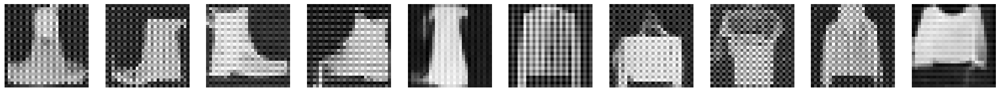

In [ ]:
bestidx=[6,9,19,20,1,85,41,52,99,90]
k=10
fig, axes = plt.subplots(1, k, figsize=(28, 28))
for j in range(k):
  i=bestidx[j]
  axes[j].imshow(imagessample[i].reshape(28, 28), cmap='gray')  # Assuming grayscale images
  axes[j].axis('off')

plt.show()

Include your most efficient implementation details below.

In [ ]:
class MultiHeadAttention(nn.Module):
    def __init__(self, num_heads, embed_dim):
        super(MultiHeadAttention, self).__init__()
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads
        self.scaler = self.head_dim ** -0.5

        self.q_heads = nn.Conv2d(embed_dim, num_heads * self.head_dim, kernel_size=1)
        self.k_heads = nn.Conv2d(embed_dim, num_heads * self.head_dim, kernel_size=1)
        self.v_heads = nn.Conv2d(embed_dim, num_heads * self.head_dim, kernel_size=1)
        self.out = nn.Conv2d(embed_dim, embed_dim, kernel_size=1)

    def forward(self, x):
        batch_size, channels, height, width = x.size()
        seq_len = height * width

        # Linear transformations
        queries = self.q_heads(x)
        keys = self.k_heads(x)
        values = self.v_heads(x)

        # Reshape queries, keys, and values
        queries = queries.view(batch_size, self.num_heads, self.head_dim, seq_len).permute(0, 3, 1, 2)
        keys = keys.view(batch_size, self.num_heads, self.head_dim, seq_len).permute(0, 3, 1, 2)
        values = values.view(batch_size, self.num_heads, self.head_dim, seq_len).permute(0, 3, 1, 2)

        # Compute attention scores
        attention_scores = torch.einsum("bqhd,bkhd->bhqk", queries, keys)
        attention_scores = attention_scores / self.scaler
        attention_weights = torch.softmax(attention_scores, dim=-1)

        # Apply attention to values
        attended_values = torch.einsum("bhqk,bkhd->bqhd", attention_weights, values)

        # Combine the heads
        attended_values = attended_values.permute(0, 2, 1, 3).contiguous().view(batch_size, -1, height, width)
        output = self.out(attended_values)

        return output

class BetterUnet(nn.Module):
# Code to make your most efficient setup goes here; present all code from above in one Code block
# run it to show final runtimes and print out the total number of parameters in the mode.class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 1
        down_channels = (28,56,112) # These are the channels that we want to obtain in the downsampling stage; DEFINE YOURSELF!
        up_channels = (112,56,28) # These are the channels that we want to obtain in the upsampling stage; DEFINE YOURSELF!
        out_dim = 1 # DEFINE THIS CORRECTLY
        time_emb_dim = 28 # DEFINE THIS CORRECTLY

        # Time embedding consists of a Sinusoidal embedding, a linear map that maintains the dimensions and a rectified linear unit activation.
        # TO WRITE CODE
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection consisting of a map from image_channels to down_channels[0] with a filter size of e.g. 3 and padding of 1.
        # TO WRITE CODE
        self.projection = nn.Conv2d(image_channels,down_channels[0], 3, padding=1)

        # Downsample: use the Blocks given above to define down_channels number of downsampling operations. These operations should cha
        # TO WRITE CODE HERE; HINT: use something like Block(down_channels[i], down_channels[i+1], time_emb_dim) the right number of times.
        self.downsamples = nn.ModuleList([
            Block(down_channels[i], down_channels[i+1], time_emb_dim, up = False) for i in range(len(down_channels) - 1)
        ])

        self.attention = MultiHeadAttention(2,down_channels[-1])

        # Upsample
        # TO WRITE CODE HERE; same logic as the downsample
        self.upsamples = nn.ModuleList([
            Block(up_channels[i], up_channels[i+1], time_emb_dim, up = True) for i in range(len(up_channels) - 1)
        ])

        # Final output: given by a final convolution that maps up_channels[-1] to out_dim with a kernel of size 1.
        # TO WRITE CODE
        self.final_conv = nn.Conv2d(up_channels[-1], out_dim, kernel_size=1)


    def forward(self, x, timestep):
        # Embedd time
        # TO DO
        # Initial conv
        # TO DO
        # Unet: iterate through the downsampling operations and the upsampling operations. Do not forget to include the residual connections
        # between the outputs from the downsample stage and the upsample stage.
        # Embedd time
        t = self.time_mlp(timestep)
        #print(t.size())
        # Initial conv
        x = self.projection(x)
        #print(x.size())
        # Unet
        residual_inputs = []
        for down in self.downsamples:
            x = down(x, t)
            residual_inputs.append(x)
        x = self.attention(x) +x
        for up in self.upsamples:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.final_conv(x)


model1 = BetterUnet()
print("Num params: ", sum(p.numel() for p in model1.parameters()))

Num params:  762497


In [ ]:
from torch.optim import Adam


device = "cuda" if torch.cuda.is_available() else "cpu"
model = BetterUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 45 # Try more!
training_imgs=[]
for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()
      img=batch.get('pixel_values')

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model,img, t)
      loss.backward()
      optimizer.step()

      if step % 100 == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        if step==100 and epoch %3==0:
          trimg = sample(model,shape)
          training_imgs.append(trimg[-1])

Num params:  762497
Epoch 0 | step 000 Loss: 1.0541751384735107 
Epoch 0 | step 100 Loss: 0.13487385213375092 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 266.35it/s]


Epoch 0 | step 200 Loss: 0.11607536673545837 
Epoch 0 | step 300 Loss: 0.11652975529432297 
Epoch 0 | step 400 Loss: 0.1014074981212616 
Epoch 1 | step 000 Loss: 0.12343114614486694 
Epoch 1 | step 100 Loss: 0.12045151740312576 
Epoch 1 | step 200 Loss: 0.08448953181505203 
Epoch 1 | step 300 Loss: 0.11476610600948334 
Epoch 1 | step 400 Loss: 0.10474821925163269 
Epoch 2 | step 000 Loss: 0.07977110147476196 
Epoch 2 | step 100 Loss: 0.10347147285938263 
Epoch 2 | step 200 Loss: 0.11563527584075928 
Epoch 2 | step 300 Loss: 0.09312791377305984 
Epoch 2 | step 400 Loss: 0.11999350041151047 
Epoch 3 | step 000 Loss: 0.11028338223695755 
Epoch 3 | step 100 Loss: 0.09991418570280075 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 266.65it/s]


Epoch 3 | step 200 Loss: 0.09629619121551514 
Epoch 3 | step 300 Loss: 0.11202755570411682 
Epoch 3 | step 400 Loss: 0.11281176656484604 
Epoch 4 | step 000 Loss: 0.0944790244102478 
Epoch 4 | step 100 Loss: 0.09478672593832016 
Epoch 4 | step 200 Loss: 0.07861438393592834 
Epoch 4 | step 300 Loss: 0.0886010229587555 
Epoch 4 | step 400 Loss: 0.09024786204099655 
Epoch 5 | step 000 Loss: 0.09966564178466797 
Epoch 5 | step 100 Loss: 0.13735294342041016 
Epoch 5 | step 200 Loss: 0.13317199051380157 
Epoch 5 | step 300 Loss: 0.1098553016781807 
Epoch 5 | step 400 Loss: 0.0998518168926239 
Epoch 6 | step 000 Loss: 0.1021634191274643 
Epoch 6 | step 100 Loss: 0.10819637030363083 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 263.64it/s]


Epoch 6 | step 200 Loss: 0.09596789628267288 
Epoch 6 | step 300 Loss: 0.09357242286205292 
Epoch 6 | step 400 Loss: 0.09571502357721329 
Epoch 7 | step 000 Loss: 0.10674338042736053 
Epoch 7 | step 100 Loss: 0.08126978576183319 
Epoch 7 | step 200 Loss: 0.09069330990314484 
Epoch 7 | step 300 Loss: 0.10842689126729965 
Epoch 7 | step 400 Loss: 0.08908583223819733 
Epoch 8 | step 000 Loss: 0.09092778712511063 
Epoch 8 | step 100 Loss: 0.10034432262182236 
Epoch 8 | step 200 Loss: 0.09147407114505768 
Epoch 8 | step 300 Loss: 0.0919884517788887 
Epoch 8 | step 400 Loss: 0.11884009093046188 
Epoch 9 | step 000 Loss: 0.11865074187517166 
Epoch 9 | step 100 Loss: 0.08280258625745773 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 263.39it/s]


Epoch 9 | step 200 Loss: 0.08890220522880554 
Epoch 9 | step 300 Loss: 0.0787188783288002 
Epoch 9 | step 400 Loss: 0.09953447431325912 
Epoch 10 | step 000 Loss: 0.09688317030668259 
Epoch 10 | step 100 Loss: 0.09964912384748459 
Epoch 10 | step 200 Loss: 0.09400352090597153 
Epoch 10 | step 300 Loss: 0.11571832001209259 
Epoch 10 | step 400 Loss: 0.08604709059000015 
Epoch 11 | step 000 Loss: 0.10572300106287003 
Epoch 11 | step 100 Loss: 0.08719175308942795 
Epoch 11 | step 200 Loss: 0.08854752033948898 
Epoch 11 | step 300 Loss: 0.0860329270362854 
Epoch 11 | step 400 Loss: 0.10195872187614441 
Epoch 12 | step 000 Loss: 0.10855748504400253 
Epoch 12 | step 100 Loss: 0.08198577165603638 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 201.70it/s]


Epoch 12 | step 200 Loss: 0.09128794074058533 
Epoch 12 | step 300 Loss: 0.08623041212558746 
Epoch 12 | step 400 Loss: 0.07640775293111801 
Epoch 13 | step 000 Loss: 0.09647347778081894 
Epoch 13 | step 100 Loss: 0.09474921226501465 
Epoch 13 | step 200 Loss: 0.10085854679346085 
Epoch 13 | step 300 Loss: 0.08694981038570404 
Epoch 13 | step 400 Loss: 0.0988955944776535 
Epoch 14 | step 000 Loss: 0.08400024473667145 
Epoch 14 | step 100 Loss: 0.09394314885139465 
Epoch 14 | step 200 Loss: 0.09128089994192123 
Epoch 14 | step 300 Loss: 0.10514085739850998 
Epoch 14 | step 400 Loss: 0.13176028430461884 
Epoch 15 | step 000 Loss: 0.12820543348789215 
Epoch 15 | step 100 Loss: 0.10195963829755783 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 263.30it/s]


Epoch 15 | step 200 Loss: 0.08877302706241608 
Epoch 15 | step 300 Loss: 0.09124837070703506 
Epoch 15 | step 400 Loss: 0.09008444100618362 
Epoch 16 | step 000 Loss: 0.08929997682571411 
Epoch 16 | step 100 Loss: 0.09183982014656067 
Epoch 16 | step 200 Loss: 0.08696833997964859 
Epoch 16 | step 300 Loss: 0.08454810827970505 
Epoch 16 | step 400 Loss: 0.0900672897696495 
Epoch 17 | step 000 Loss: 0.084867462515831 
Epoch 17 | step 100 Loss: 0.0898839607834816 
Epoch 17 | step 200 Loss: 0.09571012854576111 
Epoch 17 | step 300 Loss: 0.11157536506652832 
Epoch 17 | step 400 Loss: 0.10142525285482407 
Epoch 18 | step 000 Loss: 0.0924217626452446 
Epoch 18 | step 100 Loss: 0.12340155243873596 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 259.93it/s]


Epoch 18 | step 200 Loss: 0.10459455847740173 
Epoch 18 | step 300 Loss: 0.0870477482676506 
Epoch 18 | step 400 Loss: 0.12690529227256775 
Epoch 19 | step 000 Loss: 0.10303568840026855 
Epoch 19 | step 100 Loss: 0.10891930013895035 
Epoch 19 | step 200 Loss: 0.09736946225166321 
Epoch 19 | step 300 Loss: 0.10920693725347519 
Epoch 19 | step 400 Loss: 0.08480089157819748 
Epoch 20 | step 000 Loss: 0.10138727724552155 
Epoch 20 | step 100 Loss: 0.1045449748635292 
Epoch 20 | step 200 Loss: 0.11110348254442215 
Epoch 20 | step 300 Loss: 0.10330846160650253 
Epoch 20 | step 400 Loss: 0.08368457853794098 
Epoch 21 | step 000 Loss: 0.08811379969120026 
Epoch 21 | step 100 Loss: 0.09597133100032806 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 258.34it/s]


Epoch 21 | step 200 Loss: 0.09749443829059601 
Epoch 21 | step 300 Loss: 0.12004712969064713 
Epoch 21 | step 400 Loss: 0.11984860152006149 
Epoch 22 | step 000 Loss: 0.10906033217906952 
Epoch 22 | step 100 Loss: 0.1075860932469368 
Epoch 22 | step 200 Loss: 0.09353619813919067 
Epoch 22 | step 300 Loss: 0.10376745462417603 
Epoch 22 | step 400 Loss: 0.08134853094816208 
Epoch 23 | step 000 Loss: 0.09828343242406845 
Epoch 23 | step 100 Loss: 0.07718329131603241 
Epoch 23 | step 200 Loss: 0.08194872736930847 
Epoch 23 | step 300 Loss: 0.08799207210540771 
Epoch 23 | step 400 Loss: 0.07700072228908539 
Epoch 24 | step 000 Loss: 0.10259559750556946 
Epoch 24 | step 100 Loss: 0.0832691341638565 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 260.16it/s]


Epoch 24 | step 200 Loss: 0.09775374829769135 
Epoch 24 | step 300 Loss: 0.08104873448610306 
Epoch 24 | step 400 Loss: 0.07835735380649567 
Epoch 25 | step 000 Loss: 0.08368394523859024 
Epoch 25 | step 100 Loss: 0.08033057302236557 
Epoch 25 | step 200 Loss: 0.0981966033577919 
Epoch 25 | step 300 Loss: 0.09987708181142807 
Epoch 25 | step 400 Loss: 0.11033380776643753 
Epoch 26 | step 000 Loss: 0.10731533169746399 
Epoch 26 | step 100 Loss: 0.08403094857931137 
Epoch 26 | step 200 Loss: 0.08145991712808609 
Epoch 26 | step 300 Loss: 0.09056003391742706 
Epoch 26 | step 400 Loss: 0.09312662482261658 
Epoch 27 | step 000 Loss: 0.08590590953826904 
Epoch 27 | step 100 Loss: 0.09604152292013168 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 267.20it/s]


Epoch 27 | step 200 Loss: 0.09662937372922897 
Epoch 27 | step 300 Loss: 0.1016094982624054 
Epoch 27 | step 400 Loss: 0.0688827782869339 
Epoch 28 | step 000 Loss: 0.08546749502420425 
Epoch 28 | step 100 Loss: 0.07732150703668594 
Epoch 28 | step 200 Loss: 0.08875026553869247 
Epoch 28 | step 300 Loss: 0.09154342859983444 
Epoch 28 | step 400 Loss: 0.08243869245052338 
Epoch 29 | step 000 Loss: 0.08003158122301102 
Epoch 29 | step 100 Loss: 0.12194780260324478 
Epoch 29 | step 200 Loss: 0.1024603545665741 
Epoch 29 | step 300 Loss: 0.10952192544937134 
Epoch 29 | step 400 Loss: 0.12076406180858612 
Epoch 30 | step 000 Loss: 0.09856435656547546 
Epoch 30 | step 100 Loss: 0.10081343352794647 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 237.25it/s]


Epoch 30 | step 200 Loss: 0.0831194519996643 
Epoch 30 | step 300 Loss: 0.08073943108320236 
Epoch 30 | step 400 Loss: 0.08314527571201324 
Epoch 31 | step 000 Loss: 0.10350900888442993 
Epoch 31 | step 100 Loss: 0.08310708403587341 
Epoch 31 | step 200 Loss: 0.09514598548412323 
Epoch 31 | step 300 Loss: 0.09085306525230408 
Epoch 31 | step 400 Loss: 0.08881381899118423 
Epoch 32 | step 000 Loss: 0.08699306845664978 
Epoch 32 | step 100 Loss: 0.06996962428092957 
Epoch 32 | step 200 Loss: 0.09576034545898438 
Epoch 32 | step 300 Loss: 0.08046454936265945 
Epoch 32 | step 400 Loss: 0.08193185180425644 
Epoch 33 | step 000 Loss: 0.10278455168008804 
Epoch 33 | step 100 Loss: 0.10503185540437698 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 215.79it/s]


Epoch 33 | step 200 Loss: 0.1097816526889801 
Epoch 33 | step 300 Loss: 0.08417631685733795 
Epoch 33 | step 400 Loss: 0.09359574317932129 
Epoch 34 | step 000 Loss: 0.08572525531053543 
Epoch 34 | step 100 Loss: 0.0903581902384758 
Epoch 34 | step 200 Loss: 0.10379276424646378 
Epoch 34 | step 300 Loss: 0.07527907192707062 
Epoch 34 | step 400 Loss: 0.0650792270898819 
Epoch 35 | step 000 Loss: 0.08090843260288239 
Epoch 35 | step 100 Loss: 0.08550459891557693 
Epoch 35 | step 200 Loss: 0.08242826163768768 
Epoch 35 | step 300 Loss: 0.0903780609369278 
Epoch 35 | step 400 Loss: 0.08846971392631531 
Epoch 36 | step 000 Loss: 0.08724759519100189 
Epoch 36 | step 100 Loss: 0.08523387461900711 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 261.83it/s]


Epoch 36 | step 200 Loss: 0.07704414427280426 
Epoch 36 | step 300 Loss: 0.09574150294065475 
Epoch 36 | step 400 Loss: 0.08535546809434891 
Epoch 37 | step 000 Loss: 0.0906396210193634 
Epoch 37 | step 100 Loss: 0.08676083385944366 
Epoch 37 | step 200 Loss: 0.09348031878471375 
Epoch 37 | step 300 Loss: 0.08414101600646973 
Epoch 37 | step 400 Loss: 0.08796313405036926 
Epoch 38 | step 000 Loss: 0.10665155947208405 
Epoch 38 | step 100 Loss: 0.08698604255914688 
Epoch 38 | step 200 Loss: 0.08430321514606476 
Epoch 38 | step 300 Loss: 0.07619912177324295 
Epoch 38 | step 400 Loss: 0.08088412135839462 
Epoch 39 | step 000 Loss: 0.10026421397924423 
Epoch 39 | step 100 Loss: 0.0780678316950798 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 258.79it/s]


Epoch 39 | step 200 Loss: 0.0932847186923027 
Epoch 39 | step 300 Loss: 0.1063440814614296 
Epoch 39 | step 400 Loss: 0.0894567221403122 
Epoch 40 | step 000 Loss: 0.10009695589542389 
Epoch 40 | step 100 Loss: 0.09806704521179199 
Epoch 40 | step 200 Loss: 0.13198363780975342 
Epoch 40 | step 300 Loss: 0.08873879164457321 
Epoch 40 | step 400 Loss: 0.08197889477014542 
Epoch 41 | step 000 Loss: 0.09168415516614914 
Epoch 41 | step 100 Loss: 0.07835633307695389 
Epoch 41 | step 200 Loss: 0.09112712740898132 
Epoch 41 | step 300 Loss: 0.08428186923265457 
Epoch 41 | step 400 Loss: 0.08997543156147003 
Epoch 42 | step 000 Loss: 0.08735232055187225 
Epoch 42 | step 100 Loss: 0.08720128983259201 


sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 267.31it/s]


Epoch 42 | step 200 Loss: 0.09508264064788818 
Epoch 42 | step 300 Loss: 0.08678144216537476 
Epoch 42 | step 400 Loss: 0.09216544032096863 
Epoch 43 | step 000 Loss: 0.07750602811574936 
Epoch 43 | step 100 Loss: 0.07278301566839218 
Epoch 43 | step 200 Loss: 0.06892695277929306 
Epoch 43 | step 300 Loss: 0.0910181999206543 
Epoch 43 | step 400 Loss: 0.08275115489959717 
Epoch 44 | step 000 Loss: 0.11103513836860657 
Epoch 44 | step 100 Loss: 0.1468094140291214 
Epoch 44 | step 200 Loss: 0.09128978848457336 
Epoch 44 | step 300 Loss: 0.12211362272500992 
Epoch 44 | step 400 Loss: 0.0865742415189743 


In [ ]:
# Code for the plotting of samples goes here
shape=(1, 1, IMG_SIZE, IMG_SIZE)
imagessample=[]
for j in range(100):

  imagessam = sample(model,shape)
  imagessample.append(imagessam[-1])

sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 260.80it/s]


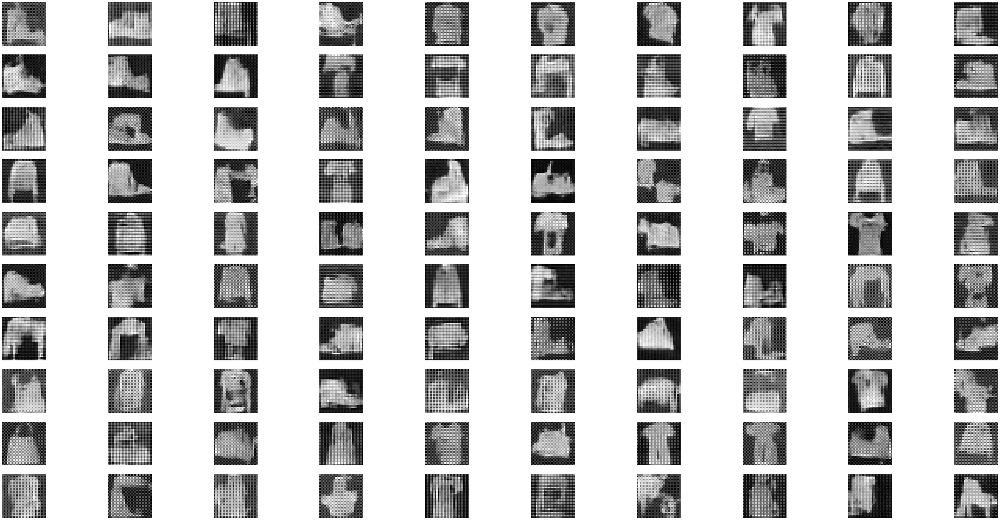

In [ ]:
fig, axes = plt.subplots(10, 10, figsize=(64, 32))
for j in range(10):
  for idx in range(10):

    axes[j][idx].imshow(imagessample[j*10+idx].reshape(28, 28),cmap='gray')  # Assuming grayscale images
    axes[j][idx].axis('off')

plt.show()

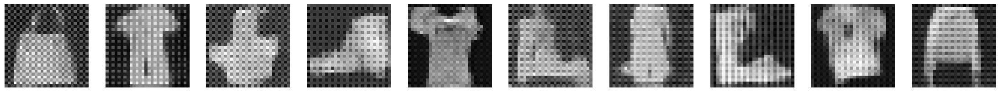

In [ ]:
bestidx=[80,86,93,44,48,0,42,25,78,30]
k=10
fig, axes = plt.subplots(1, k, figsize=(28, 28))
for j in range(k):
  i=bestidx[j]
  axes[j].imshow(imagessample[i].reshape(28, 28), cmap='gray')  # Assuming grayscale images
  axes[j].axis('off')
      #plt.title(f'Timestep {i+1}')
plt.show()

Interpretation of your results goes here. By looking at the training images sampled at various points during training, shirt like images start to take resemble shirts early on an a bit later we have a well defined shoe. By later epochs all the shirt like images look clearly like shirts. Near the end, the bag image still lacks a handle which shows the model has not quite learnt about handles.

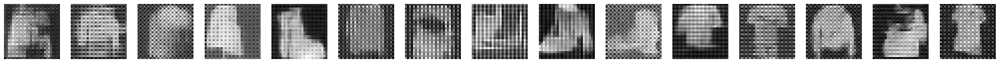

In [ ]:
# Here goes the code for visualising during training and add a discussion above.

fig, axes = plt.subplots(1, 15, figsize=(32, 16))
for j in range(15):

  axes[j].imshow(training_imgs[j].reshape(28, 28),cmap='gray')  # Assuming grayscale images
  axes[j].axis('off')

plt.show()

### Part 3. On DeepDream [5 points]

In this task we will implement a DeepDream model in order to generate ‘dreams’: images enhanced by the neural network.

Here we will work with a pre-trained model (Inception-V3). The idea is as follows: we will load some image (you can later on choose to load your own image if you want). We will load the Inception-V3 model. We will pass it an input and obtain the activation outputs from a certain layer. We will 'ask' the neural network to maximise the values of the activation, i.e. enhance the image with what those layer activations 'like' to see. For this we will implement a gradient ascent method in order to maximise a norm of the activations over that input. This will change our input into a `dream'.

1. [1 point] Write a piece of code that will load the Inception-V3 model and allow you to get access to the intermediate activations.

2. [2 points] Implement the deepdream optimisation loop. We will use gradient ascent to optimise for the norm of the activation. Implement a function that performs this gradient ascent. This function will take as input the number of iterations to perform, the learning rate, and the start image (i.e. the image which the model will enhance). Define in the function a for loop over the number of iterations, obtain the model output, get the output of the hook (hint: use something like `outputs[-1]`), compute the loss which will be L2 norm of this output (i.e. the L2 norm of the activations from your chosen layer), compute the gradients of this L2 norm loss, scale the gradients by their absolute average (hint: scale using `torch.abs(g).mean()`) and define a gradient ascent step over the image. Do not forget to zero out gradients where needed.

3. [1 point] Implement code to load an image (e.g. https://github.com/pytorch/hub/raw/master/images/dog.jpg) and display the output from your optimisation loop (using e.g. numpy). Present the generated images for different choices of layer activations and different number of optimisation steps. Discuss your results. What is the impact of using different layers? What is the impact of the number of optimisation steps? [0.5 point will be given for the implementation and 1.5 point for a very good discussion]

4. [1 point] In our previous setting we allowed for optimising for a single layer's activation. Change the method such that it will allow to compute the loss (L2 norm) of multiple layers' outputs. Present three different setups using different numbers & combinations of layers and discuss your results in max. 3 lines.

In [ ]:
# YOUR ANSWERS GO HERE

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import numpy as np
import requests
from io import BytesIO



# Function to load Inception-V3 model and register hook for intermediate activations
def load_model_and_hook():
    inception_v3 = models.inception_v3(pretrained=True,progress=True)
    # Choose the layer whose activations you want to maximize
    target_layer = inception_v3.Conv2d_2a_3x3 # For example, Mixed_7c
    # Register a hook to get the activations from the chosen layer
    hook = LayerActivationsHook(target_layer)
    return inception_v3, hook

# Define a hook class to retrieve activations from a specific layer
class LayerActivationsHook:
    def __init__(self, target_layer):
        self.activations = None
        self.hook = target_layer.register_forward_hook(self.hook_fn)

    def hook_fn(self, module, input, output):
        self.activations = output

    def close(self):
        self.hook.remove()

# Function to perform gradient ascent optimization
def deepdream_optimization(image, model, hook, num_iterations, learning_rate):
    image = image.requires_grad_(True)
    imgs=[]
    for i in range(num_iterations):
        model.zero_grad()
        outputs = model(image)
        activation = hook.activations[-1]
        loss = torch.norm(activation) # L2 norm of the activation
        loss.backward()
        with torch.no_grad():
            # Scale gradients by their absolute average
            gradients = torch.abs(image.grad).mean()
            image += learning_rate * image.grad / gradients
        image.grad.zero_()
        if (i+1)>0 and (i+1)%10==0:
          a=image.detach().cpu().numpy()
          imgs.append(a.copy())
    return imgs


# Function to load and preprocess image
def load_and_preprocess_image(image_path):
    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    image = Image.open(image_path)
    image = preprocess(image).unsqueeze(0)
    return image




In [ ]:
inception_v3 = models.inception_v3(pretrained=True,progress=True)

iterations=30
import urllib
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")


a=urllib.request.urlretrieve(url, filename)

image = load_and_preprocess_image(a[0])
dreams=[]
learning_rate = 0.1

for layer in range(3):
  inception_v3 = models.inception_v3(pretrained=True,progress=True)
  if layer==0:
    target_layer=inception_v3.Conv2d_2a_3x3
  elif layer==1:
    target_layer = inception_v3.Mixed_6b
  else:
    target_layer= inception_v3.avgpool

  hook = LayerActivationsHook(target_layer)


    # Perform deepdream optimization
  dream_image = deepdream_optimization(image, inception_v3, hook, iterations, learning_rate)
  dreams.append(dream_image.copy())

  hook.close()

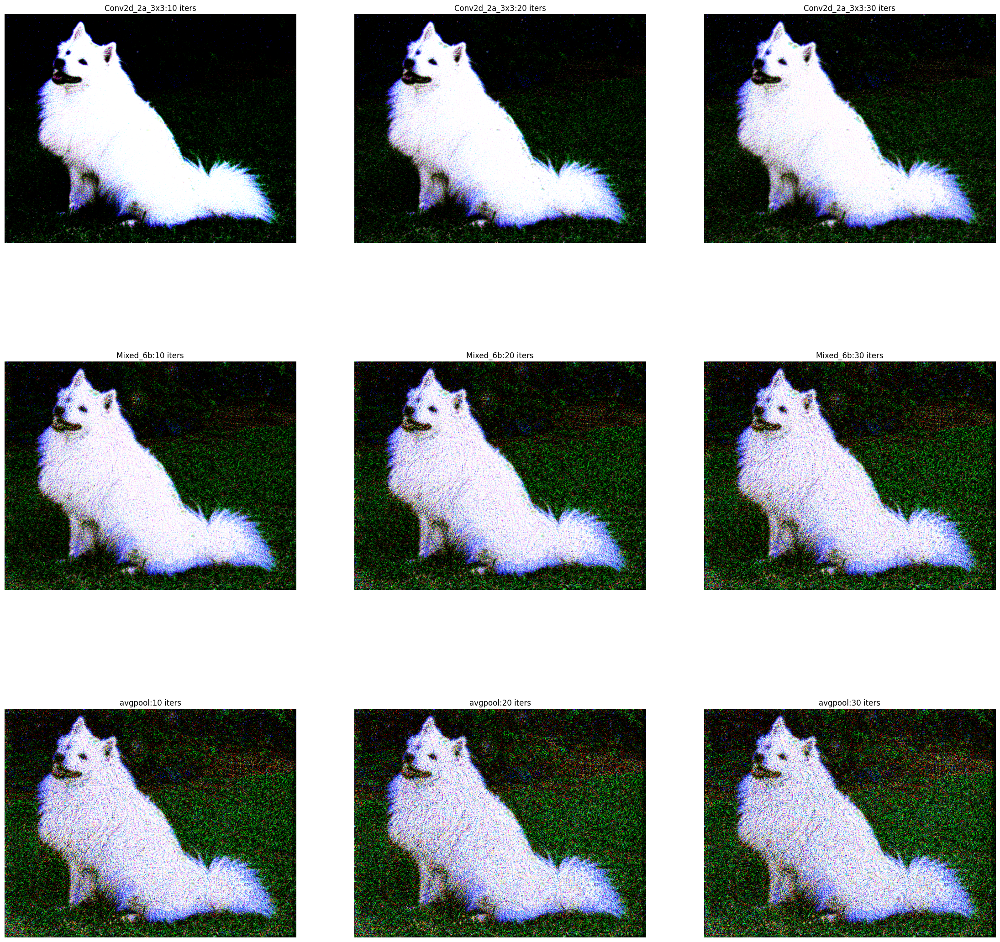

In [ ]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(3, 3, figsize=(28, 28))
for j in range(3):
  for k in range(3):
  #i=bestidx[j]
    dream = dreams[j][k]
    dream = np.transpose(dream.squeeze(), (1, 2, 0))
    dream= np.clip(dream, 0, 1)
    dream= Image.fromarray(np.uint8(dream * 255))
    axes[j][k].imshow(dream)
    axes[j][k].axis('off')
      #plt.title(f'Timestep {i+1}')
axes[0][0].set_title("Conv2d_2a_3x3:10 iters")
axes[0][1].set_title("Conv2d_2a_3x3:20 iters")
axes[0][2].set_title("Conv2d_2a_3x3:30 iters")
axes[1][0].set_title("Mixed_6b:10 iters")
axes[1][1].set_title("Mixed_6b:20 iters")
axes[1][2].set_title("Mixed_6b:30 iters")
axes[2][0].set_title("avgpool:10 iters")
axes[2][1].set_title("avgpool:20 iters")
axes[2][2].set_title("avgpool:30 iters")
plt.show()

We used three different layers, an early layer, a layer in the middle and one of the final layers. We find that with the early layer generates an image with a very dark and not well defined background, whereas with the late layer, avgpool, we have a welldefined dog and bright background. For all three images, the image becomes much noisier after more iterations evident on the dog's fur. We suggest that maximising activation for the early layer adds noise for the dog but mostly ignores the background, maximising activation output for middle and late layer makes the whole image brighter and noisier, more so for avgpool, the later layer.

Choose three different settings. Below we present three different settings, where setting 1 uses 4 layers, `[inception_v3.avgpool,inception_v3.Conv2d_1a_3x3, inception_v3.Mixed_5b,inception_v3.Mixed_6e]`, setting 2 uses 3 layers,`[inception_v3.Conv2d_1a_3x3, inception_v3.maxpool2,inception_v3.Mixed_5d]` and setting 3 uses 2 layers, `[inception_v3.maxpool1,inception_v3.Mixed_7c]`. We plot the images obtained after 10, 20 and 30 iterations or each setting and at the end we compare side by side the final image given by each setting.

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import numpy as np
import urllib

url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")

a=urllib.request.urlretrieve(url, filename)

start_image = load_and_preprocess_image(a[0])



# Function to perform deepdream optimization for multiple layers
def dreamer_optimization_multiple_layers(image, model, hooks, num_iterations, learning_rate):
    image = image.requires_grad_(True)
    imgs=[]
    for i in range(num_iterations):
        model.zero_grad()
        outputs = model(image)
        loss = 0
        for hook in hooks:
            activation = hook.activations[-1] # output of activation layer
            loss += torch.norm(activation) # L2 norm of the activation
        loss.backward()
        with torch.no_grad():
            # Scale gradients by their absolute average
            gradients = torch.abs(image.grad).mean()
            image += learning_rate * image.grad / gradients
        image.grad.zero_()
        if (i+1)>0 and (i+1)%10==0:
          a=image.detach().cpu().numpy()
          imgs.append(a.copy())
    return imgs





In [ ]:
drmsmult=[]
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")


a=urllib.request.urlretrieve(url, filename)

start_image = load_and_preprocess_image(a[0])


In [ ]:
inception_v3 = models.inception_v3(pretrained=True,progress=True)
target_layers = [inception_v3.avgpool,inception_v3.Conv2d_1a_3x3, inception_v3.Mixed_5b,inception_v3.Mixed_6e]

num_iterations = 30
learning_rate = 0.1

# Register hooks
hooks = [LayerActivationsHook(layer) for layer in target_layers]

# Perform optimization for multiple layers
dream_images = dreamer_optimization_multiple_layers(start_image, inception_v3, hooks, num_iterations, learning_rate)
drmsmult.append(dream_images.copy())

# Close the hooks
for hook in hooks:
    hook.close()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


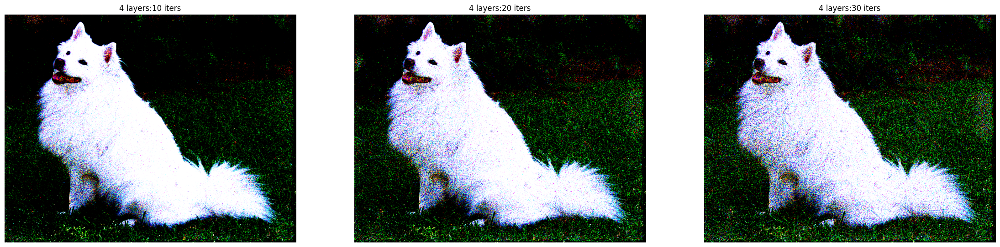

In [ ]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 3, figsize=(28, 28))
for k in range(3):

    dream = drmsmult[0][k]
    dream = np.transpose(dream.squeeze(), (1, 2, 0))
    dream= np.clip(dream, 0, 1)
    dream= Image.fromarray(np.uint8(dream * 255))
    axes[k].imshow(dream)
    axes[k].axis('off')
axes[0].set_title("4 layers:10 iters")
axes[1].set_title("4 layers:20 iters")
axes[2].set_title("4 layers:30 iters")
plt.show()

In [ ]:
inception_v3 = models.inception_v3(pretrained=True,progress=True)
target_layers = [inception_v3.Conv2d_1a_3x3, inception_v3.maxpool2,inception_v3.Mixed_5d]

num_iterations = 30
learning_rate = 0.1

# Register hooks
hooks = [LayerActivationsHook(layer) for layer in target_layers]

# Perform optimization for multiple layers
dream_images = dreamer_optimization_multiple_layers(start_image, inception_v3, hooks, num_iterations, learning_rate)
drmsmult.append(dream_images.copy())

# Close the hooks
for hook in hooks:
    hook.close()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


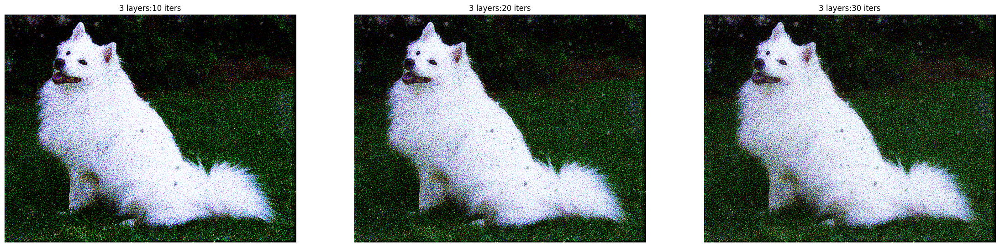

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(28, 28))
for k in range(3):

    dream = drmsmult[1][k]
    dream = np.transpose(dream.squeeze(), (1, 2, 0))
    dream= np.clip(dream, 0, 1)
    dream= Image.fromarray(np.uint8(dream * 255))
    axes[k].imshow(dream)
    axes[k].axis('off')
axes[0].set_title("3 layers:10 iters")
axes[1].set_title("3 layers:20 iters")
axes[2].set_title("3 layers:30 iters")
plt.show()

In [ ]:
inception_v3 = models.inception_v3(pretrained=True,progress=True)
target_layers = [inception_v3.maxpool1,inception_v3.Mixed_7c]

num_iterations = 30
learning_rate = 0.1

# Register hooks
hooks = [LayerActivationsHook(layer) for layer in target_layers]

# Perform optimization for multiple layers
dream_images = dreamer_optimization_multiple_layers(image, inception_v3, hooks, num_iterations, learning_rate)
drmsmult.append(dream_images.copy())

# Close the hooks
for hook in hooks:
    hook.close()

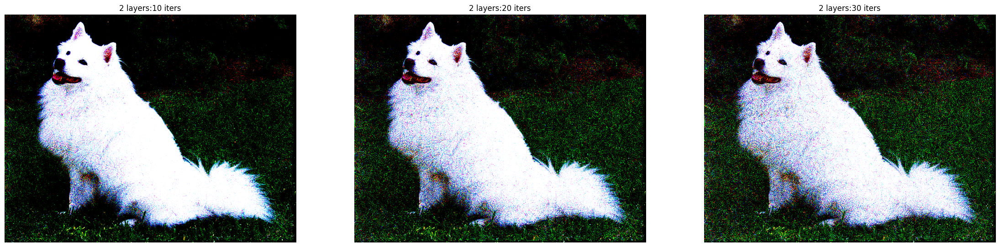

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(28, 28))
for k in range(3):

    dream = drmsmult[2][k]
    dream = np.transpose(dream.squeeze(), (1, 2, 0))
    dream= np.clip(dream, 0, 1)
    dream= Image.fromarray(np.uint8(dream * 255))
    axes[k].imshow(dream)
    axes[k].axis('off')
axes[0].set_title("2 layers:10 iters")
axes[1].set_title("2 layers:20 iters")
axes[2].set_title("2 layers:30 iters")
plt.show()

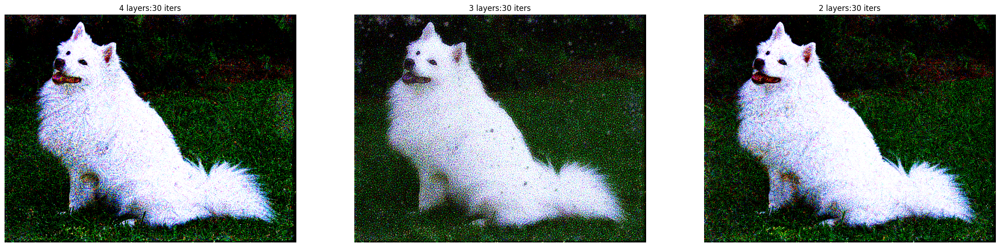

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(28, 28))
for k in range(3):

    dream = drmsmult[k][-1]
    dream = np.transpose(dream.squeeze(), (1, 2, 0))
    dream= np.clip(dream, 0, 1)
    dream= Image.fromarray(np.uint8(dream * 255))
    axes[k].imshow(dream)
    axes[k].axis('off')
axes[0].set_title("4 layers:30 iters")
axes[1].set_title("3 layers:30 iters")
axes[2].set_title("2 layers:30 iters")

plt.show()

We notice the definiton of the image produced by 4 layers is the sharpest with all the edges of the dog being well defined whereas the 3 layers image is much less sharp. we note setting 2 does not utilise any late layer and uses early or middle ones which suggests the later layers help accentuate the dog ears, background and sharpness. Another note is that the image generated by setting 1 has well defined grass whereas the other two the background looks more like dots.